<h1><center>Laboratorio 6: La solicitud de Sergio 🤗</center></h1>

<center><strong>MDS7202: Laboratorio de Programación Científica para Ciencia de Datos</strong></center>

### Cuerpo Docente:

- Profesores: Ignacio Meza, Sebastián Tinoco
- Auxiliar: Catherine Benavides
- Ayudante: Nicolás Ojeda, Eduardo Moya

### Equipo: Los Galácticos
- Nombre de alumno 1: Arturo Marín
- Nombre de alumno 2: Martín González


### **Link de repositorio de GitHub:** https://github.com/ArturoMarin9/Laboratorios-MDS7202-1

## Temas a tratar
- Aplicar Pandas para obtener características de un DataFrame.
- Aplicar Pipelines y Column Transformers.
- Utilizar diferentes algoritmos de cluster y ver el desempeño.

## Reglas:

- **Grupos de 2 personas**
- Cualquier duda fuera del horario de clases al foro. Mensajes al equipo docente serán respondidos por este medio.
- Prohibidas las copias.
- Pueden usar cualquer matrial del curso que estimen conveniente.
- Código que no se pueda ejecutar, no será revisado.

### Objetivos principales del laboratorio
- Comprender cómo aplicar pipelines de Scikit-Learn para generar clusters.
- Familiarizarse con plotly.

El laboratorio deberá ser desarrollado sin el uso indiscriminado de iteradores nativos de python (aka "for", "while"). La idea es que aprendan a exprimir al máximo las funciones optimizadas que nos entrega `numpy`, las cuales vale mencionar, son bastante más eficientes que los iteradores nativos sobre arreglos (*o tensores*).

## Descripción del laboratorio

<center>
<img src="https://i.pinimg.com/originals/5a/a6/af/5aa6afde8490da403a21601adf7a7240.gif" width=400 />

En el corazón de las operaciones de Aerolínea Lucero, Sergio, el gerente de análisis de datos, reunió a un talentoso equipo de jóvenes científicos de datos para un desafío crucial: segmentar la base de datos de los clientes. “Nuestro objetivo es descubrir patrones en el comportamiento de los pasajeros que nos permitan personalizar servicios y optimizar nuestras campañas de marketing,” explicó Sergio, mientras desplegaba un amplio rango de datos que incluían desde hábitos de compra hasta opiniones sobre los vuelos.

Sergio encargó a los científicos de datos la tarea de aplicar técnicas avanzadas de clustering para identificar distintos segmentos de clientes, como los viajeros frecuentes y aquellos que eligen la aerolínea para celebrar ocasiones especiales. La meta principal era entender profundamente cómo estos grupos perciben la calidad y satisfacción de los servicios ofrecidos por la aerolínea.

A través de un enfoque meticuloso y colaborativo, los científicos de datos se abocaron a la tarea, buscando transformar los datos brutos en valiosos insights que permitirían a Aerolínea Lucero no solo mejorar su servicio, sino también fortalecer las relaciones con sus clientes mediante una oferta más personalizada y efectiva.

## Importamos librerias utiles 😸

In [1]:
import numpy as np
import time
import pandas as pd

from sklearn import datasets
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

## 1. Estudio de Performance 📈



<center>
<img src="https://user-images.githubusercontent.com/57133330/188281408-c67df9ee-fd1f-4b37-833b-f02848f1ce02.gif" width=300>

Don Sergio les ha encomendado su primera tarea: analizar diversas técnicas de clustering. Su objetivo es entender detalladamente cómo funcionan estos métodos en términos de segmentación y eficiencia en tiempo de ejecución.

Analice y compare el desempeño, tiempo de ejecución y visualizaciones de cuatro algoritmos de clustering (k-means, DBSCAN, Ward y GMM) aplicados a tres conjuntos de datos, incrementando progresivamente su tamaño. Utilice Plotly para las gráficas y discuta los resultados tanto cualitativa como cuantitativamente.

Uno de los requisitos establecidos por Sergio es que el análisis se lleve a cabo utilizando Plotly; de no ser así, se considerará incorrecto. Para facilitar este proceso, se ha proporcionado un código de Plotly que puede servir como base para realizar las gráficas. Apóyese en el código entregado para efectuar el análisis y tome como referencia la siguiente imagen para realizar los gráficos:

<img src='https://gitlab.com/imezadelajara/datos_clase_7_mds7202/-/raw/main/misc_images/Screenshot_2024-04-26_at_9.10.44_AM.png' width=300 />

En el gráfico se visualizan en dos dimensiones los diferentes tipos de datos proporcionados en `datasets`. Cada columna corresponde a un modelo de clustering diferente, mientras que cada fila representa un conjunto de datos distinto. Cada uno de los gráficos incluye el tiempo en segundos que tarda el análisis y la métrica Silhouette obtenida.

Para ser más específicos, usted debe cumplir los siguientes objetivos:
1. Generar una función que permita replicar el gráfico expuesto en la imagen (no importa que los colores calcen). [4 puntos]
2. Ejecuta la función para un `n_samples` igual a 1000, 5000, 20000. [2 puntos]
3. Analice y compare el desempeño, tiempo de ejecución y visualizaciones de cuatro algoritmos de clustering. [4 puntos]


> ❗ Tiene libertad absoluta de escoger los hiper parámetros de los cluster, sin embargo, se recomienda verificar el dominio de las variables para realizar la segmentación.
> ❗ Recuerde que es obligatorio el uso de plotly.


In [2]:
"""
En la siguiente celda se crean los datos ficticios a usar en la sección 1 del lab.
❗No realice cambios a esta celda
"""

# Datos a utilizar

# Configuracion
n_samples = 5000

# Lunas
moons = datasets.make_moons(n_samples=n_samples, noise=0.05, random_state=30)

# Blobs
blobs = datasets.make_blobs(n_samples=n_samples, random_state=172)

# Datos desiguales
transformation = [[0.6, -0.6], [-0.4, 0.8]]
mutated = (np.dot(blobs[0], transformation), blobs[1])

# Generamos Dataset
datasets = {
    'moons':{
        'x': moons[0], 'classes': moons[1], 'n_cluster': 2
    },
    'blobs':{
        'x': blobs[0], 'classes': blobs[1], 'n_cluster': 3
    },
    'mutated':{
        'x': mutated[0], 'classes': mutated[1], 'n_cluster': 3
    }
}

In [3]:
# Función scatter
def plot_scatter(x, y, color):
    fig = go.Figure(data=[go.Scatter(
        x=x, y=y, mode='markers',
        marker=dict(
            size=8,
            color=color,  # corresponde a una variable por el cual colorear
            showscale=False  # esconde la escala de color
        )
    )])
    return fig

# Multiples plots con plotly
fig = make_subplots(rows=3, cols=1)
fig.add_trace(
    plot_scatter(
        x=datasets['moons']['x'][:, 0],
        y=datasets['moons']['x'][:, 1],
        color=datasets['moons']['classes']
    )._data[0],
    row=1, col=1
)
fig.add_trace(
    plot_scatter(
        x=datasets['blobs']['x'][:, 0],
        y=datasets['blobs']['x'][:, 1],
        color=datasets['blobs']['classes']
    )._data[0],
    row=2, col=1
)
fig.add_trace(
    plot_scatter(
        x=datasets['mutated']['x'][:, 0],
        y=datasets['mutated']['x'][:, 1],
        color=datasets['mutated']['classes']
    )._data[0],
    row=3, col=1
)
fig.update_layout(
    showlegend=False, template='simple_white'
)

**Respuestas:**

In [4]:
# 1.
# Función que permite replicar el gráfico expuesto en la imagen del enunciado

# Define clustering functions
def apply_kmeans(data):
    start = time.time()
    kmeans = KMeans(n_clusters=int(np.max(data['classes']) + 1), random_state=42)
    labels = kmeans.fit_predict(data['x'])
    duration = time.time() - start
    silhouette = silhouette_score(data['x'], labels)
    return labels, duration, silhouette

def apply_gmm(data):
    start = time.time()
    gmm = GaussianMixture(n_components=int(np.max(data['classes']) + 1), random_state=42)
    labels = gmm.fit_predict(data['x'])
    duration = time.time() - start
    silhouette = silhouette_score(data['x'], labels)
    return labels, duration, silhouette

def apply_ward(data):
    start = time.time()
    ward = AgglomerativeClustering(n_clusters=int(np.max(data['classes']) + 1), linkage='ward')
    labels = ward.fit_predict(data['x'])
    duration = time.time() - start
    silhouette = silhouette_score(data['x'], labels)
    return labels, duration, silhouette

def apply_dbscan(data):
    start = time.time()
    dbscan = DBSCAN(eps=0.45, min_samples=5)
    labels = dbscan.fit_predict(data['x'])
    duration = time.time() - start
    silhouette = silhouette_score(data['x'], labels) if np.unique(labels).size > 1 else -1  # DBSCAN may result in a single cluster
    return labels, duration, silhouette

# Function to apply all methods to all datasets and plot the results
def plot_all_clusters(datasets):
    methods = {'Kmeans': apply_kmeans, 'GMM': apply_gmm, 'WARD': apply_ward, 'DBSCAN': apply_dbscan}
    num_datasets = len(datasets)
    num_methods = len(methods)
    titles = [f"{method}" for method in methods for _ in range(num_datasets)]  # Generate initial titles list

    fig = make_subplots(rows=num_datasets, cols=num_methods, subplot_titles=titles)

    title_updates = []
    for i, (dataset_name, data) in enumerate(datasets.items(), start=1):
        for j, (method_name, method) in enumerate(methods.items(), start=1):
            labels, duration, silhouette = method(data)
            title = f"{method_name} {duration:.2f} [s] | s: {silhouette:.2f}"
            title_updates.append(title)
            fig.add_trace(
                plot_scatter(
                    x=data['x'][:, 0],
                    y=data['x'][:, 1],
                    color=labels
                )._data[0],
                row=i, col=j
            )

    # Update subplot titles with execution times and silhouette scores
    for k in range(len(title_updates)):
        fig.layout.annotations[k].update(text=title_updates[k])

    fig.update_layout(height=900, width=1200, title_text="Comparación de tiempos de ejecución y métrica Silhouette por técnica", showlegend=False)
    return fig

In [5]:
# 2.
# Ejecutando la función para distintos valores de n_samples
from sklearn import datasets
import warnings
warnings.filterwarnings('ignore')

# Function to generate datasets
def generate_datasets(n_samples):
    # Generate Lunas dataset
    moons = datasets.make_moons(n_samples=n_samples, noise=0.05, random_state=30)

    # Generate Blobs dataset
    blobs = datasets.make_blobs(n_samples=n_samples, random_state=172)

    # Generate Mutated dataset
    transformation = [[0.6, -0.6], [-0.4, 0.8]]
    mutated = (np.dot(blobs[0], transformation), blobs[1])

    generated_datasets = {
        'moons': {
            'x': moons[0], 'classes': moons[1], 'n_cluster': 2
        },
        'blobs': {
            'x': blobs[0], 'classes': blobs[1], 'n_cluster': 3
        },
        'mutated': {
            'x': mutated[0], 'classes': mutated[1], 'n_cluster': 3
        }
    }
    return generated_datasets

# Create datasets for different n_samples and run clustering
sample_sizes = [1000, 5000, 20000]

for size in sample_sizes:
    print(f"Running clustering for sample size: {size}")
    current_datasets = generate_datasets(size)  # Use a different variable name
    fig = plot_all_clusters(current_datasets)
    fig.show()

Running clustering for sample size: 1000


Running clustering for sample size: 5000


Running clustering for sample size: 20000


3. Analice y compare el desempeño, tiempo de ejecución y visualizaciones de los cuatro algoritmos de clustering.

#### 1. **Tiempo de Ejecución**
- **Kmeans** y **GMM** muestran tiempos de ejecución relativamente rápidos en todos los tamaños de muestra, aunque Kmeans tiende a ser más lento que GMM. Esto es típico ya que Kmeans necesita ajustar los centroides iterativamente, lo que puede ser más intensivo computacionalmente.
- **WARD** (clustering jerárquico) consistentemente muestra tiempos de ejecución significativamente más largos, que aumentan dramáticamente con el tamaño de la muestra.
- **DBSCAN** exhibe tiempos de ejecución muy bajos, especialmente notables en tamaños de muestra más grandes.

#### 2. **Puntuaciones de Silueta (Silhouette)**
- Las **Puntuaciones de Silueta** sugieren diversos grados de ajuste dependiendo del algoritmo y la estructura del conjunto de datos. Puntuaciones más altas generalmente indican clusters mejor definidos y separados.
- **GMM** tiende a desempeñarse consistentemente bien en términos de puntuación de Silueta, lo que podría indicar su eficacia para manejar las distribuciones gaussianas en los conjuntos de datos con los que estámos trabajando.
- **DBSCAN** muestra un rendimiento muy pobre (puntuaciones negativas) en ciertas configuraciones, indicando un clustering inapropiado donde los clusters están asignados incorrectamente o excesivamente fragmentados, esto puede deberse a la sensibilidad de sus parámetros `eps` y `min_samples`.

#### 3. **Análisis Visual**
  - **Moons dataset** (fila superior de los gráficos): Tanto Kmeans como GMM logran capturar las dos formas de luna razonablemente bien, aunque GMM ligeramente supera con un límite de cluster más natural debido a su naturaleza probabilística. WARD y DBSCAN muestran resultados variados, con DBSCAN a veces fallando completamente en distinguir los dos clusters dependiendo de la configuración de los parámetros.
  - **Blobs dataset** (fila del medio): Todos los algoritmos generalmente funcionan bien con blobs gaussianos bien separados y distintos. El rendimiento aquí es bastante robusto en todos los tamaños de muestra para Kmeans y GMM.
  - **Mutated dataset** (fila inferior): Este conjunto de datos parece más desafiante, particularmente para DBSCAN y WARD. Kmeans y GMM muestran un clustering más consistente a través de varios tamaños de muestra.

#### 4. **Escalabilidad**
- **La escalabilidad** con respecto al tamaño de la muestra es un problema claro para WARD, que muestra un aumento drástico en el tiempo de cálculo a medida que aumenta el número de muestras. Kmeans y GMM escalan mejor, siendo GMM particularmente fuerte en términos de tiempo y calidad de clustering.
- El rendimiento de **DBSCAN** es altamente dependiente de los parámetros, lo que puede llevar a resultados de ejecución muy rápidos o inadecuadamente lentos, y a veces a resultados de clustering pobres.


## 2. Análisis de Satisfacción de Vuelos

<center>
<img src="https://i.gifer.com/2Hci.gif" width=400 />

Habiendo entendido cómo funcionan los modelos de aprendizaje no supervisado, *Don Sergio* le encomienda estudiar la satisfacción de pasajeros al haber tomado un vuelo en alguna de sus aerolineas. Para esto, el magnate le dispone del dataset `aerolineas_licer.parquet`, el cual contiene el grado de satisfacción de los clientes frente a diferentes aspectos del vuelo. Las características del vuelo se definen a continuación:

- *Gender*: Género de los pasajeros (Femenino, Masculino)
- *Customer Type*: Tipo de cliente (Cliente habitual, cliente no habitual)
- *Age*: Edad actual de los pasajeros
- *Type of Travel*: Propósito del vuelo de los pasajeros (Viaje personal, Viaje de negocios)
- *Class*: Clase de viaje en el avión de los pasajeros (Business, Eco, Eco Plus)
- *Flight distance*: Distancia del vuelo de este viaje
- *Inflight wifi service*: Nivel de satisfacción del servicio de wifi durante el vuelo (0:No Aplicable; 1-5)
- *Departure/Arrival time convenient*: Nivel de satisfacción con la conveniencia del horario de salida/llegada
- *Ease of Online booking*: Nivel de satisfacción con la facilidad de reserva en línea
- *Gate location*: Nivel de satisfacción con la ubicación de la puerta
- *Food and drink*: Nivel de satisfacción con la comida y la bebida
- *Online boarding*: Nivel de satisfacción con el embarque en línea
- *Seat comfort*: Nivel de satisfacción con la comodidad del asiento
- *Inflight entertainment*: Nivel de satisfacción con el entretenimiento durante el vuelo
- *On-board service*: Nivel de satisfacción con el servicio a bordo
- *Leg room service*: Nivel de satisfacción con el espacio para las piernas
- *Baggage handling*: Nivel de satisfacción con el manejo del equipaje
- *Check-in service*: Nivel de satisfacción con el servicio de check-in
- *Inflight service*: Nivel de satisfacción con el servicio durante el vuelo
- *Cleanliness*: Nivel de satisfacción con la limpieza
- *Departure Delay in Minutes*: Minutos de retraso en la salida
- *Arrival Delay in Minutes*: Minutos de retraso en la llegada

En consideración de lo anterior, realice las siguientes tareas:

0. Ingeste el dataset a su ambiente de trabajo.

1. Seleccione **sólo las variables numéricas del dataset**.  Explique qué éfectos podría usar variables categóricas en un algoritmo no supervisado. Los datos se encuentran en el siguiente [enlace](https://gitlab.com/imezadelajara/datos_clase_7_mds7202/-/raw/main/aerolineas_lucer.parquet). [2 puntos]

2. Realice una visualización de la distribución de cada variable y analice cada una de estas distribuciones. [2 puntos]

3. Basándose en los gráficos, evalúe la necesidad de escalar los datos y explique el motivo de su decisión. [2 puntos]

4. Examine la correlación entre las variables mediante un correlograma. [2 puntos]

5. De acuerdo con los resultados obtenidos en 5, reduzca la dimensionalidad del conjunto de datos a cuatro variables, justificando su elección respecto a las variables que decide eliminar. [2 puntos]

**Respuesta:**

In [6]:
# Si usted está utilizando Colabolatory le puede ser útil este código para cargar los archivos.
try:
    from google.colab import drive
    drive.mount("/content/drive")
    path = 'Mi unidad/Otoño 2024/Lab MDS/Laboratorios/Lab 6'
except:
    print('Ignorando conexión drive-colab')

Mounted at /content/drive


In [7]:
# 0.
# Carga de datos
df = pd.read_parquet('/content/drive/My Drive/Otoño 2024/Lab MDS/Laboratorios/Lab 6/aerolineas_lucer.parquet')
# Mostrar las primeras filas del conjunto de datos
df.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,5,4,3.0,4,4.0,5.0,5,25,18.0
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,1,5.0,3,1.0,4.0,1,1,6.0
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,5,4,3.0,4,4.0,4.0,5,0,0.0
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,2,5.0,3,1.0,4.0,2,11,9.0
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,5,3,3,4.0,4,3.0,3.0,3,0,0.0


In [8]:
# 1.
# Seleccionar solo las variables numéricas
numeric_df = df.select_dtypes(include=['int64', 'float64'])

numeric_df= numeric_df.drop(columns=['id'])

# Mostrar las variables numéricas
numeric_df.head()


,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
0,13,460,3,4,3,1,5,3,5,5,4,3.0,4,4.0,5.0,5,25,18.0
1,25,235,3,2,3,3,1,3,1,1,1,5.0,3,1.0,4.0,1,1,6.0
2,26,1142,2,2,2,2,5,5,5,5,4,3.0,4,4.0,4.0,5,0,0.0
3,25,562,2,5,5,5,2,2,2,2,2,5.0,3,1.0,4.0,2,11,9.0
4,61,214,3,3,3,3,4,5,5,3,3,4.0,4,3.0,3.0,3,0,0.0


En algoritmos no supervisados, las variables categóricas pueden desempeñar un papel crucial en la identificación de patrones y estructuras dentro de los datos. Por ejemplo, en técnicas de clustering como K-Means, estas variables se utilizan para agrupar observaciones en conjuntos homogéneos, lo que permite descubrir segmentos de clientes o comportamientos similares en un conjunto de datos. Además, en técnicas de visualización como t-SNE, las variables categóricas pueden influir en la disposición de los puntos en un espacio de menor dimensionalidad, lo que facilita la identificación de relaciones y agrupaciones entre diferentes categorías.

Es esencial manejar adecuadamente las variables categóricas en el proceso de análisis no supervisado, utilizando técnicas de codificación como el one-hot encoding para representarlas de manera adecuada. Esto asegura que la información contenida en estas variables se utilice de manera efectiva para revelar patrones y estructuras subyacentes en los datos, lo que a su vez permite tomar decisiones informadas basadas en el análisis realizado.

In [9]:
# 2.
# Itera sobre cada columna del DataFrame
for column in numeric_df.columns:
    # Crea una figura con subplots
    fig = make_subplots(rows=1, cols=2, subplot_titles=(f'Distribución de {column}', f'Diagrama de caja de {column}'))

    # Histograma
    fig.add_trace(
        go.Histogram(x=numeric_df[column], nbinsx=20),
        row=1, col=1
    )

    # Diagrama de caja
    fig.add_trace(
        go.Box(y=numeric_df[column], boxpoints='outliers', jitter=0.3, pointpos=-1.8),
        row=1, col=2
    )

    # Actualiza el diseño y etiquetas
    fig.update_layout(title=f'Análisis de {column}', showlegend=False)
    fig.update_xaxes(title_text=column, row=1, col=1)
    fig.update_yaxes(title_text='Frecuencia', row=1, col=1)
    fig.update_yaxes(title_text=column, row=1, col=2)

    # Muestra la figura
    fig.show()

En relación a los gráficos se ditrubicón obtenidos, se tiene que:

* Para la variable 'Age' se observa una distribución inclinada a un comportamiento normal, donde las edades se concentran entre los 20 y 60 años aproximadamente.

* Para la variable 'Flight Distance' se tiene que la distribución de concentra a la izquierda, esto para valores que no superan una distancia de 1000. Además, se observa que los valores van desde 0 hasta 4000, un intervalo bastante grande.

* Para variables como 'Inflight wifi service’ y ‘Ease of Online booking' se tiene una dispersión mas bien uniforme y con una leve concentración para valores del centro de la escala como 2 y 3.

* Para variables como 'Departure/Arrival time convenient’, 'Gate location' 'Food and drink’, 'Online boarding’, 'Seat comfort',  'Inflight entertainment’, 'On-board service’, 'Leg room service', 'Baggage handling', 'Checkin service', Inflight service' y ‘Cleanliness’, la distribución también podría considerarse como uniforme pero con una inclinación hacia la derecha, esto es valores altos para la escala con valores como 4 o 5.

* Para variables como 'Departure Delay in Minutes' y 'Arrival Delay in Minutes’se tienen distribuciones muy concentrada en ciertos valores, específicamente valores bajos, esto es bajo 200. Además llega a valores muy altos como aproximadamente 1000.

3. Al considerar escalar los datos, las variables a escalar serían 'Departir Delay in minutes', 'Arrival Delay in minutes' y 'Flight Distance’, esto principalmente porque el rango en el que se encuentran sus valores son bastante altos,  además, la concentración de los datos se encuentra principalmente en valores bajos, lo que serían comparados después con valores como 1000, 2000 o hasta 4000.

In [10]:
# 4.
# Calcula la matriz de correlación
correlation_matrix = numeric_df.corr()

# Obtén las etiquetas de las variables
variables = correlation_matrix.index.tolist()

# Crea una figura de Plotly con un mapa de calor
fig = make_subplots(rows=1, cols=1)
fig.add_trace(go.Heatmap(z=correlation_matrix.values,
                         x=variables,
                         y=variables,
                         colorscale='Viridis',
                         zmin=-1, zmax=1),
              row=1, col=1)

# Actualiza el diseño y las etiquetas
fig.update_layout(title='Correlograma de las Variables',
                  xaxis_title='Variables',
                  yaxis_title='Variables')

# Muestra la figura
fig.show()


Los resultados de la matriz de correlaciones revelan diversas relaciones entre las variables del conjunto de datos. Se observa una correlación positiva moderada entre las variables "Online boarding" y "Seat comfort" , lo que sugiere que los pasajeros que califican positivamente el proceso de embarque en línea tienden a valorar también el confort del asiento durante el vuelo. Además, se destaca una fuerte correlación positiva entre las variables "Food and drink" y "Cleanliness", indicando que los pasajeros que están satisfechos con la calidad de la comida y bebida a bordo también tienden a percibir el nivel de limpieza de la aeronave de manera positiva. Estas correlaciones podrían ser consideradas al seleccionar variables para reducir la dimensionalidad del conjunto de datos, ya que podrían representar aspectos similares de la experiencia del cliente y, por lo tanto, podrían ser redundantes en un análisis más compacto.

Por otro lado, se observa una correlación negativa significativa entre las variables "Departure Delay in Minutes" y "Arrival Delay in Minutes", lo que indica una fuerte asociación entre los retrasos en la salida y los retrasos en la llegada de los vuelos. Esta alta correlación sugiere que una de estas variables podría ser suficiente para representar los retrasos en el análisis, lo que justificaría su eliminación para reducir la dimensionalidad del conjunto de datos. Sin embargo, la decisión final de qué variables conservar o eliminar debe basarse en consideraciones adicionales, como la relevancia de las variables para los objetivos del análisis y la interpretación de los resultados obtenidos.

5. En relación a lo obtenido en las visualizaciones realizadas anteriormente, las variables que se escogen para trabajar son:

* **Age:** Es una variable más dispersa por lo que podría entregar una mayor información colaborar en la formación e clusters.

* **Inflight entertainment:** Es una variable con una distribución relativamente uniforme y es probable que tenga un impacto significativo en la satisfacción general del pasajero. Además, muestra correlaciones moderadas con otros servicios a bordo, lo que sugiere que podría ser un indicador clave de la experiencia general a bordo.

* **Cleanliness:** Esta variable también muestra una buena distribución a lo largo de las categorías y es crucial para la percepción del pasajero sobre la calidad de la aerolínea. La limpieza está también moderadamente correlacionada con varias otras variables de servicio, lo que indica su importancia en la percepción general del servicio.

* **Ease of Online booking:** Se selecciona debido a su distribución relativamente equilibrada entre múltiples niveles de satisfacción. Aunque los niveles 2 y 3 pueden ser ligeramente más comunes, otros niveles también muestran una cantidad significativa de elecciones, lo que sugiere que esta variable podría proporcionar información útil para identificar patrones en los clusters.


## 3. Preprocesamiento 🎭

<center>
<img src="https://i.pinimg.com/originals/1e/a8/0e/1ea80e7cea0d429146580c7e91c5b944.gif" width=400>

Tras quedar satisfecho con los resultados presentados en el punto 2, el dueño de la empresa ha solicitado que se preprocesen los datos mediante un `pipeline`. Es crucial que este proceso tenga en cuenta las observaciones derivadas de los análisis anteriores. Adicionalmente, ha expresado su interés en visualizar el conjunto de datos en un gráfico de dos o tres dimensiones.

Basándose en los análisis realizados anteriormente:
1. Cree un `pipeline` que incluya PCA, utilizando las consideraciones mencionadas previamente para proyectar los datos a dos dimensiones. [4 puntos]
2. Grafique los resultados obtenidos y comente lo visualizado. [6 puntos]

**Respuestas:**

In [11]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# Cargar datos
# Asegúrate de que el DataFrame 'df' ya esté cargado con los datos apropiados
# df = pd.read_parquet('ruta_al_archivo.parquet')

# Seleccionar las columnas de interés
data = df[['Age', 'Inflight entertainment', 'Cleanliness', 'Ease of Online booking']]

# Pipeline para la preparación de datos y PCA
pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Escala los datos para tener media 0 y varianza 1
    ('pca', PCA(n_components=2))   # Reducción de dimensionalidad a 2 componentes principales
])

# Ajustar el pipeline a los datos
transformed_data = pipeline.fit_transform(data)

# Crear un nuevo DataFrame con los componentes principales
pca_df = pd.DataFrame(transformed_data, columns=['PC1', 'PC2'])

print(pca_df.head())

        PC1       PC2
0 -1.558275 -1.165511
1  2.571633 -0.117721
2 -1.624105 -1.200669
3  1.420527  0.857971
4  0.144188  1.048990


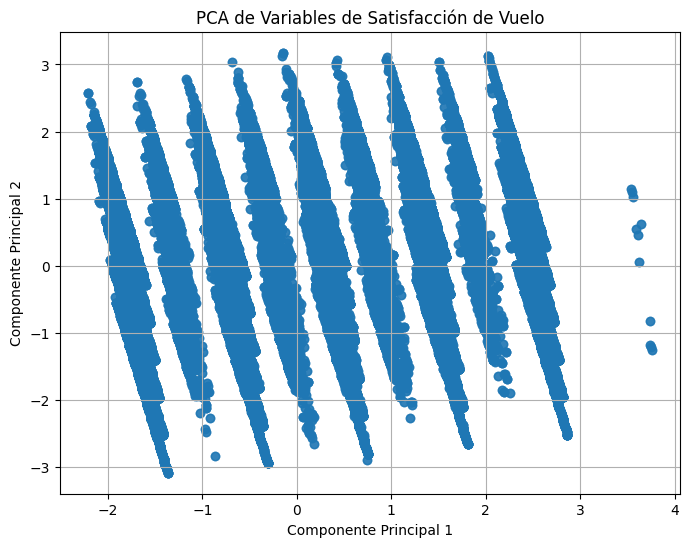

In [12]:
# Graficar los componentes principales
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.scatter(pca_df['PC1'], pca_df['PC2'], alpha=0.7)
plt.title('PCA de Variables de Satisfacción de Vuelo')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.show()

Algunos puntos destacables, basados en el gráfico anterior, son:

1. **Patrones Claros**: Se observa una serie de líneas verticales bien definidas en el gráfico, lo que sugiere que hay grupos distintos o niveles dentro de los datos. Este patrón podría indicar que ciertas combinaciones de las variables originales tienden a agruparse juntas repetidamente.

2. **Dispersión Horizontal**: La dispersión a lo largo del Componente Principal 1 (horizontal) es bastante amplia, lo que indica que este componente capta una cantidad significativa de la varianza total en el dataset. Esto sugiere que el CP1 es eficaz para diferenciar entre registros basados en sus características subyacentes.

3. **Dispersión Vertical Limitada**: En comparación con el CP1, el Componente Principal 2 (vertical) muestra menos variabilidad. Esto sugiere que, aunque el CP2 contribuye a la explicación de la varianza, su impacto es menor comparado con el CP1.

4. **Posibles Interpretaciones**:
   - **CP1** podría estar capturando variaciones principalmente asociadas a la edad, dada su amplia dispersión y considerando que la edad tiene un rango más amplio comparado con las otras variables que son categóricas y limitadas de 0 a 5.
   - **CP2** podría estar influenciado por combinaciones específicas de las calificaciones de los servicios, posiblemente reflejando diferencias en percepciones o experiencias de servicios específicos que no varían tanto como la edad.


## 4. Outliers 🚫🙅‍♀️❌🙅‍♂️

<center>
<img src="https://joachim-gassen.github.io/images/ani_sim_bad_leverage.gif" width=250>

Con el objetivo de mantener la claridad en su análisis, Don Sergio le ha solicitado entrenar un modelo que identifique pasajeros con comportamientos altamente atípicos.

1. Utilice `IsolationForest` para clasificar las anomalías del dataset, configurando el modelo para que sólo el 1% de los datos sean considerados anómalos. Asegúrese de integrar esta tarea dentro de un `pipeline`. [3 puntos]

2. Visualice los resultados en el gráfico de dos dimensiones previamente creado. [3 puntos]

3. ¿Cómo evaluaría el rendimiento de su modelo en la detección de anomalías? [4 puntos]

**Respuestas:**

In [13]:
from sklearn.ensemble import IsolationForest

# Definir el pipeline para la detección de anomalías
anomaly_pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Escalado de características
    ('isolation_forest', IsolationForest(contamination=0.01))  # Detección de anomalías con IsolationForest
])

# Ajustar el pipeline a los datos
anomaly_pipeline.fit(data)


Pipeline(steps=[('scaler', StandardScaler()),
                ('isolation_forest', IsolationForest(contamination=0.01))])

In [14]:
# Predicciones de anomalías utilizando el pipeline
anomaly_predictions = anomaly_pipeline.predict(data)

# Añadir las predicciones de anomalías al DataFrame de datos transformados
pca_df['Anomaly'] = anomaly_predictions

# Filtrar los datos para separar anomalías de datos normales
normal_data = pca_df[pca_df['Anomaly'] == 1]
anomalous_data = pca_df[pca_df['Anomaly'] == -1]

# Crear un gráfico de dispersión 2D con anomalías resaltadas
fig = px.scatter(pca_df, x='PC1', y='PC2', color='Anomaly',
                 title='Resultados de PCA con Detección de Anomalías')

# Añadir puntos para anomalías
fig.add_trace(go.Scatter(x=anomalous_data['PC1'], y=anomalous_data['PC2'],
                         mode='markers', marker=dict(color='red', size=8),
                         name='Anomalías'))

# Mostrar el gráfico
fig.show()

Al analizar el rendimiento del modelo de detección de anomalías en el gráfico de dispersión 2D, observamos que la mayoría de las instancias se clasifican como normales, como se evidencia por el predominio del color amarillo (correspondiente al valor 1 en la columna "Anomaly"). Sin embargo, a medida que el valor de la componente principal PC1 aumenta por encima de cero, comenzamos a observar la aparición de puntos de color azul, asociados al valor -1 en la clasificación de anomalías. Esta tendencia sugiere que a medida que nos alejamos del origen en la dirección positiva de PC1, el modelo identifica un mayor número de anomalías. Aunque los puntos azules son pocos, su presencia indica que el modelo está detectando algunas instancias que se desvían significativamente del comportamiento normal del conjunto de datos. Sin embargo, es crucial realizar una evaluación más detallada del rendimiento del modelo utilizando métricas específicas y considerando cómo se distribuyen las anomalías en relación con el conjunto de datos en su totalidad.

## 5. Métricas de Desempeño 🚀

<center>
<img src="https://giffiles.alphacoders.com/219/219081.gif" width=300>

Motivado por incrementar su fortuna, Don Sergio le solicita entrenar un modelo que le permita segmentar a los pasajeros en grupos distintos, con el objetivo de optimizar las diversas campañas de marketing diseñadas por su equipo. Para ello, le se pide realizar las siguientes tareas:

1. Utilizar el modelo **Gaussian Mixture** y explore diferentes configuraciones de número de clústers, específicamente entre 3 y 8. Asegúrese de integrar esta operación dentro de un `pipeline`. [4 puntos]
2. Explique cuál sería el criterio adecuado para seleccionar el número óptimo de clústers. **Justifique de forma estadistica y a traves de gráficos.** [6 puntos]

> **HINT:** Se recomienda investigar sobre los criterios AIC y BIC para esta tarea.

**Respuestas:**

In [15]:
from sklearn.mixture import GaussianMixture

# Definir el pipeline para el clustering con Gaussian Mixture
def gmm_pipeline(num_clusters):
    pipeline = Pipeline([
        ('scaler', StandardScaler()),  # Escalado de características
        ('gmm', GaussianMixture(n_components=num_clusters, random_state=42))  # Modelo Gaussian Mixture
    ])
    return pipeline

# Lista para almacenar los resultados de los diferentes números de clústers
gmm_results = []

# Lista para almacenar los criterios AIC y BIC
aic_scores = []
bic_scores = []

# Explorar diferentes configuraciones de número de clústers entre 3 y 8
for num_clusters in range(3, 9):
    # Crear y ajustar el pipeline para el número actual de clústers
    pipeline = gmm_pipeline(num_clusters)
    pipeline.fit(data)

    # Guardar el modelo
    gmm_results.append({
        'Num Clusters': num_clusters,
        'Pipeline': pipeline
    })

    # Calcular AIC y BIC y almacenar los resultados
    aic = pipeline.named_steps['gmm'].aic(data)
    bic = pipeline.named_steps['gmm'].bic(data)
    aic_scores.append(aic)
    bic_scores.append(bic)

    print(f"Número de clústers: {num_clusters}, AIC: {aic}, BIC: {bic}")

# Imprimir los valores de AIC y BIC para cada iteración
for i in range(len(aic_scores)):
    print(f"Iteración {i+3}: AIC = {aic_scores[i]}, BIC = {bic_scores[i]}")

Número de clústers: 3, AIC: 845744794.4672109, BIC: 845745250.8382916
Número de clústers: 4, AIC: 725393049.4261988, BIC: 725393661.3783299
Número de clústers: 5, AIC: 671463958.95681, BIC: 671464726.4899913
Número de clústers: 6, AIC: 700290786.7019469, BIC: 700291709.8161784
Número de clústers: 7, AIC: 696626632.7298956, BIC: 696627711.4251775
Número de clústers: 8, AIC: 729150675.8751647, BIC: 729151910.1514969
Iteración 3: AIC = 845744794.4672109, BIC = 845745250.8382916
Iteración 4: AIC = 725393049.4261988, BIC = 725393661.3783299
Iteración 5: AIC = 671463958.95681, BIC = 671464726.4899913
Iteración 6: AIC = 700290786.7019469, BIC = 700291709.8161784
Iteración 7: AIC = 696626632.7298956, BIC = 696627711.4251775
Iteración 8: AIC = 729150675.8751647, BIC = 729151910.1514969


Para seleccionar el número óptimo de clústers, es fundamental considerar criterios estadísticos que evalúen la complejidad del modelo y su capacidad de ajuste a los datos. En este caso, se pueden utilizar criterios como el AIC (Criterio de Información de Akaike) y el BIC (Criterio de Información Bayesiano). Estos criterios penalizan la complejidad del modelo y premian su capacidad de ajuste, lo que ayuda a evitar el sobreajuste.

Al observar los resultados , podemos notar que tanto el AIC como el BIC disminuyen a medida que aumenta el número de clústers hasta cierto punto y luego comienzan a aumentar nuevamente. Esta tendencia se puede visualizar en un gráfico donde el eje x representa el número de clústers y el eje y representa los valores de AIC y BIC. El número óptimo de clústers se encuentra en el punto donde los valores de AIC y BIC son mínimos.

En este caso, el criterio de AIC y BIC sugieren que el número óptimo de clústers es 5, ya que tanto el AIC como el BIC alcanzan su valor mínimo en ese punto. Utilizamos el criterio de AIC y BIC porque penalizan la complejidad del modelo y ofrecen un equilibrio entre el ajuste del modelo y su complejidad, lo que nos permite seleccionar un modelo que se ajuste bien a los datos sin ser demasiado complejo. Esto nos ayuda a evitar el sobreajuste y a obtener un modelo más generalizable.

## 6. Análisis de resultados 📊

<center>
<img src="https://i.gifer.com/7wTk.gif" width=300>

Una vez identificado el número óptimo de clústers, se le pide realizar lo siguiente:

1. Utilizar la proyección en dos dimensiones para visualizar cada clúster claramente. [2 puntos]

2. ¿Es posible distinguir claramente entre los clústers generados? [2 puntos]

3. Proporcionar una descripción breve de cada clúster utilizando estadísticas descriptivas básicas, como la media y la desviación estándar, para resumir las características de las variables utilizadas en estos algoritmos. [2 puntos]

4. Proceda a visualizar los clústers en tres dimensiones para una perspectiva más detallada. [2 puntos]

5. ¿Cómo afecta esto a sus conclusiones anteriores? [2 puntos]

**Respuestas:**

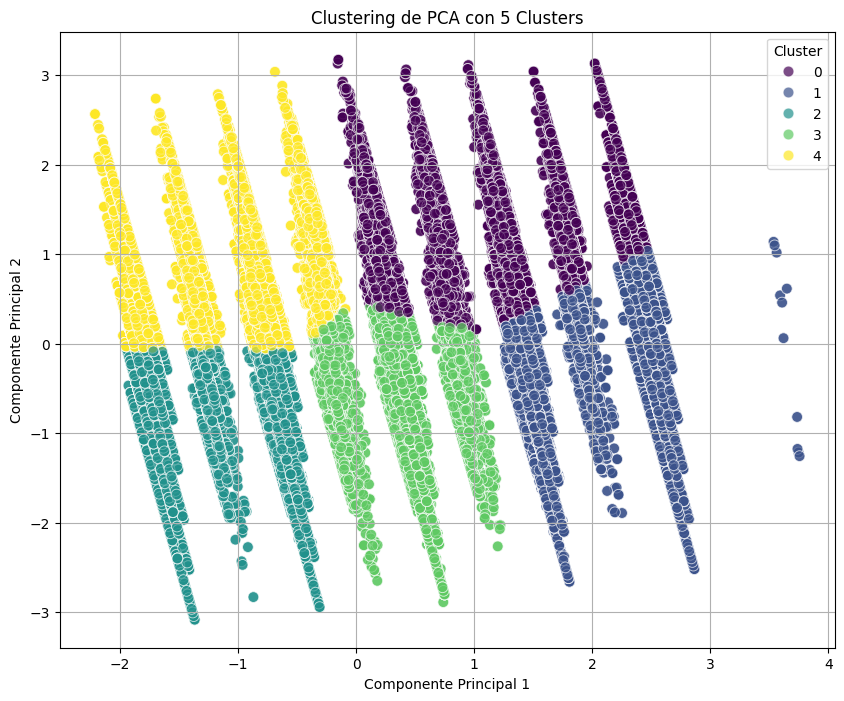

In [16]:
# Escriba su código aquí
from sklearn.cluster import KMeans
import seaborn as sns

# Aplicamos KMeans para 5 clusters
kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(transformed_data)

# Añadimos la asignación de clusters al DataFrame de PCA
pca_df['Cluster'] = clusters

# Graficamos los resultados con los clusters identificados
plt.figure(figsize=(10, 8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='viridis', s=60, alpha=0.7)
plt.title('Clustering de PCA con 5 Clusters')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()


Los clusters se distinguen claramente a lo largo de las direcciones específicas en el espacio de las componentes principales, indicando una distribución organizada. Sin embargo, la superposición entre ellos en puntos donde estas direcciones se cruzan complica la distinción precisa solo con esta visualización en dos dimensiones. Esta superposición sugiere que, aunque los clusters son visibles, identificarlos de manera definitiva requiere más que una simple observación visual de las componentes principales proyectadas.

In [17]:
# Añadimos la asignación de clusters al DataFrame original para realizar estadísticas descriptivas
data['Cluster'] = clusters

# Calcular estadísticas descriptivas para cada cluster
cluster_stats = data.groupby('Cluster').agg(['mean', 'std'])
cluster_stats

Age            Inflight entertainment           Cleanliness  \
              mean        std                   mean       std        mean   
Cluster                                                                      
0        49.113973  13.353840               2.377622  0.957446    2.304710   
1        30.082752  13.119600               1.528231  0.539845    1.528281   
2        32.809724  13.159949               4.490197  0.539485    4.443537   
3        36.118016  14.077938               3.055873  0.768787    3.048008   
4        47.319370  11.957810               4.316554  0.673554    4.129572   

                  Ease of Online booking            
              std                   mean       std  
Cluster                                             
0        0.947966               3.801093  1.022014  
1        0.546443               2.205835  1.200640  
2        0.583641               1.889534  1.032397  
3        0.729643               1.879414  1.092948  
4        0.770356               3.799898  1.008750

**Cluster 0:**
- **Edad Media**: Este grupo tiene una edad promedio más alta, alrededor de 49 años, lo que sugiere que podría consistir principalmente en viajeros maduros.
- **Entretenimiento a Bordo**: La calificación media es regular, indicando satisfacción pero con variabilidad moderada en las opiniones.
- **Limpieza**: Calificaciones regulares en limpieza, indicando que este grupo valora y percibe la higiene del avión, pero considerando puntos a mejorar.
- **Facilidad de Reserva en Línea**: También califican positivamente la facilidad de reserva en línea, con una calificación media alta.

**Cluster 1:**
- **Edad Media**: Este grupo es considerablemente más joven, con una edad media de aproximadamente 30 años.
- **Entretenimiento a Bordo**: Las calificaciones son las más bajas entre todos los grupos, lo que puede indicar insatisfacción o falta de interés en las opciones de entretenimiento ofrecidas.
- **Limpieza y Facilidad de Reserva en Línea**: Ambas características tienen calificaciones medias, indicando una percepción promedio sin grandes problemas ni puntos destacados.

**Cluster 2:**
- **Edad Media**: Edad alrededor de los 32 años.
- **Entretenimiento a Bordo y Limpieza**: Este grupo está muy satisfecho con el entretenimiento a bordo y la limpieza, mostrando las calificaciones más altas.
- **Facilidad de Reserva en Línea**: Calificaciones bajas, sugiriendo una experiencia satisfactoria sin ser excepcional.

**Cluster 3:**
- **Edad Media**: Edad promedio de 36 años, un grupo intermedio en términos de edad.
- **Entretenimiento a Bordo**: Calificaciones moderadas para entretenimiento, ligeramente por debajo del promedio.
- **Limpieza**: La limpieza es bien valorada, aunque con algo de variabilidad.
- **Facilidad de Reserva en Línea**: Calificaciones bajas, sugiriendo una experiencia satisfactoria sin ser excepcional.

**Cluster 4:**
- **Edad Media**: La edad media es de aproximadamente 47 años, indicando un grupo de edad madura.
- **Entretenimiento a Bordo**: Evaluaciones bastante altas en entretenimiento, solo ligeramente detrás del cluster 2.
- **Limpieza**: Muy satisfechos con la limpieza, con calificaciones altas y poca variabilidad.
- **Facilidad de Reserva en Línea**: Evaluaciones muy altas, lo que sugiere que la experiencia de reserva en línea es excepcionalmente buena para este grupo.

Cada cluster representa un segmento único de pasajeros basado en su edad y sus niveles de satisfacción con varios servicios de vuelo, lo cual es esencial para dirigir estrategias de marketing y mejoras en el servicio específicas para cada grupo.

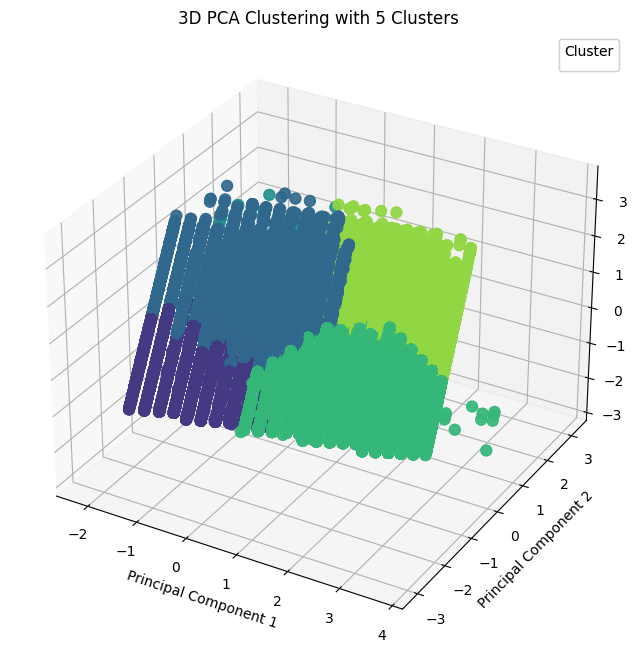

In [18]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import seaborn as sns

# Asumiendo que 'data' contiene las columnas seleccionadas ['Age', 'Inflight entertainment', 'Cleanliness', 'Ease of Online booking']
data = df[['Age', 'Inflight entertainment', 'Cleanliness', 'Ease of Online booking']]

# Escalando los datos
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

# Aplicando PCA para reducir a 3 dimensiones
pca = PCA(n_components=3)
transformed_data = pca.fit_transform(data_scaled)

# Aplicando KMeans para 5 clusters
kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(transformed_data)

# Creando un DataFrame para los resultados de PCA
pca_df = pd.DataFrame(transformed_data, columns=['PC1', 'PC2', 'PC3'])
pca_df['Cluster'] = clusters

# Preparación para plotear
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Colores para cada cluster
palette = sns.color_palette('viridis', n_colors=5)

# Ploteo
scatter = ax.scatter(pca_df['PC1'], pca_df['PC2'], pca_df['PC3'], c=pca_df['Cluster'].apply(lambda x: palette[x]), s=60, alpha=0.7)
legend = ax.legend(*scatter.legend_elements(), title="Cluster")
ax.add_artist(legend)

# Títulos y etiquetas
ax.set_title('3D PCA Clustering with 5 Clusters')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')

plt.show()

Notamos algunas características adicionales que no eran tan claras en la visualización 2D. Los clusters parecen estar más claramente separados en el espacio tridimensional, lo que facilita su distinción. Esto podría sugerir que la superposición observada en la representación en 2D era en parte un efecto de la proyección y no necesariamente indicativa de una superposición sustancial en el espacio de características original.

Al añadir una tercera dimensión, se observa que cada cluster ocupa más claramente un "volumen" distinto, lo cual podría ayudar a entender mejor las diferencias entre grupos y a validar la eficacia del modelo de clustering. Esto refuerza la idea de que la PCA y el clustering pueden revelar estructuras subyacentes complejas que no son apreciables solo con una visualización de dos componentes.